In [ ]:
labels_l3 = ["SAMPLE_NUMBER",
             "UTC_TIME",
             "EPHEMERIS_SECONDS",
             "RESIDUAL_CALIBRATED_X_BAND_FREQUENCY_SHIFT",
             "RESIDUAL_CALIBRATED_X_BAND_FREQUENCY_SHIFT_AFTER_BASELINE_FIT",
             "RECONSTRUCTED_TRANSMIT_FREQUENCY",
             #"RADIUS",
             "SIGMA_RADIUS",
             "BENDING_ANGLE",
             "SIGMA_BENDING_ANGLE",
             #"REFRACTIVE_INDEX",
             "REFRACTIVITY",
             "SIGMA_REFRACTIVITY",
             "SIGNAL_LEVEL",
             "DIFFERENTIAL_DOPPLER",
             #"LONGITUDE",
             #"LATITUDE",
             "IMPACT_PARAMETER",
             "SIGMA_IMPACT_PARAMETER"]

In [2]:
labels_l4 = ["SAMPLE_NUMBER",
             "UTC_TIME",
             "EPHEMERIS_SECONDS",
             #"RADIUS",
             #"LATITUDE",
             #"LONGITUDE",
             "GEOPOTENTIAL",
             "GEOPOTENTIAL_HEIGHT",
             "PRESSURE_LOWER_TEMPERATURE_AT_BOUNDARY",
             "SIGMA_PRESSURE_LOWER_TEMPERATURE_AT_BOUNDARY",
             "PRESSURE_MEDIUM_TEMPERATURE_AT_BOUNDARY",
             "SIGMA_PRESSURE_MEDIUM_TEMPERATURE_AT_BOUNDARY",
             #"PRESSURE_HIGHER_TEMPERATURE_AT_BOUNDARY",
             "SIGMA_PRESSURE_HIGHER_TEMPERATURE_AT_BOUNDARY",
             "TEMPERATURE_LOWER_TEMPERATURE_AT_BOUNDARY",
             "SIGMA_TEMPERATURE_LOWER_TEMPERATURE_AT_BOUNDARY",
             "TEMPERATURE_MEDIUM_TEMPERATURE_AT_BOUNDARY",
             "SIGMA_TEMPERATURE_MEDIUM_TEMPERATURE_AT_BOUNDARY",
             #"TEMPERATURE_HIGHER_TEMPERATURE_AT_BOUNDARY",
             "SIGMA_TEMPERATURE_HIGHER_TEMPERATURE_AT_BOUNDARY",
             #"NUMBER_DENSITY",
             "SIGMA_NUMBER_DENSITY",
             "SOLAR_ZENITH_ANGLE",
             "LOCAL_SOLAR_TIME"]

### Plotting variation of parameters - T, P, Number Density and $\mu$

#### Plotting temperatures

##### 2D plots with height constraints

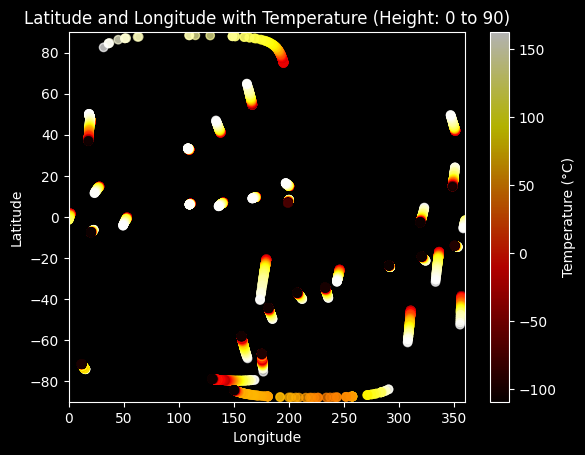

In [35]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# constraints
height_min = 0
height_max = 90
venus_radius = 6051.8

# Create a figure and axes
fig, ax = plt.subplots()

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            
# Iterate over the files in the combo folder
for csv_file in csv_files:
    file_path = os.path.basename(csv_file)
    # Load the combined dataset
    df = pd.read_csv(csv_file)

    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    temperature = df.iloc[:,18]
    height = df.iloc[:,3] - venus_radius

    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    temperature = temperature[mask]

    # Plot latitude, longitude, and temperature
    scatter = ax.scatter(longitude, latitude, c=temperature-273, cmap='hot', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Latitude and Longitude with Temperature (Height: {} to {})'.format(height_min, height_max))

# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Temperature (°C)')

# Show the plot
plt.show()


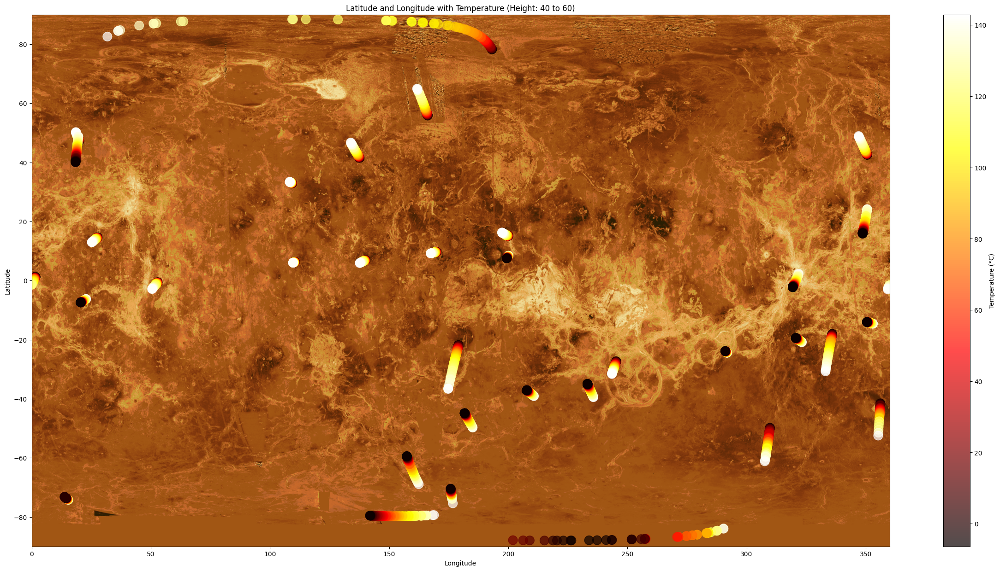

In [4]:
import os
import pandas as pd
import matplotlib.pyplot as plt


# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# constraints
height_min = 40
height_max = 60
venus_radius = 6051.8

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            
# Calculate the aspect ratio of the image
# image = plt.imread('/home/dev/Desktop/Venus/Images/venmap2.tif')
image = plt.imread('/home/dev/Desktop/Venus/Images/venmap.gif')
# image = plt.imread(image_path)
image_aspect_ratio = image.shape[1] / image.shape[0]

# Create a figure with dimensions based on the image aspect ratio
width = 30
height = width / image_aspect_ratio
fig, ax = plt.subplots(figsize=(width, height))

# Display the image as the background
ax.imshow(image, extent=[0, 360, -90, 90], aspect='auto')

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)

    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    temperature = df.iloc[:,18]
    height = df.iloc[:,3] - venus_radius

    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    temperature = temperature[mask]

    # Plot latitude, longitude, and temperature
    scatter = ax.scatter(longitude, latitude, c=temperature-273,s=200, cmap='hot', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Latitude and Longitude with Temperature (Height: {} to {})'.format(height_min, height_max))

# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Temperature (°C)')

# Show the plot
plt.show()


##### 3D plots with height constraints

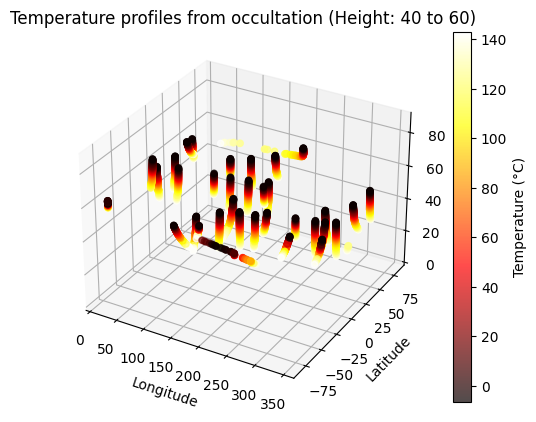

In [5]:
venus_radius = 6051.8

import os
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# Height constraints
height_min = 40
height_max = 60

# Create a figure and a 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_zlim(0, 90)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)
    
    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    temperature = df.iloc[:,18]
    height = df.iloc[:,3] - venus_radius
    
    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    temperature = temperature[mask]
    height = height[mask]
    
    # Plot latitude, longitude, and temperature within the height range
    scatter = ax.scatter(longitude, latitude, height, c=temperature-273, cmap='hot', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Height')
    ax.set_title('Temperature profiles from occultation (Height: {} to {})'.format(height_min, height_max))
        
# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Temperature (°C)')

# Show the plot
plt.show()

##### Global 3D map with height constraints

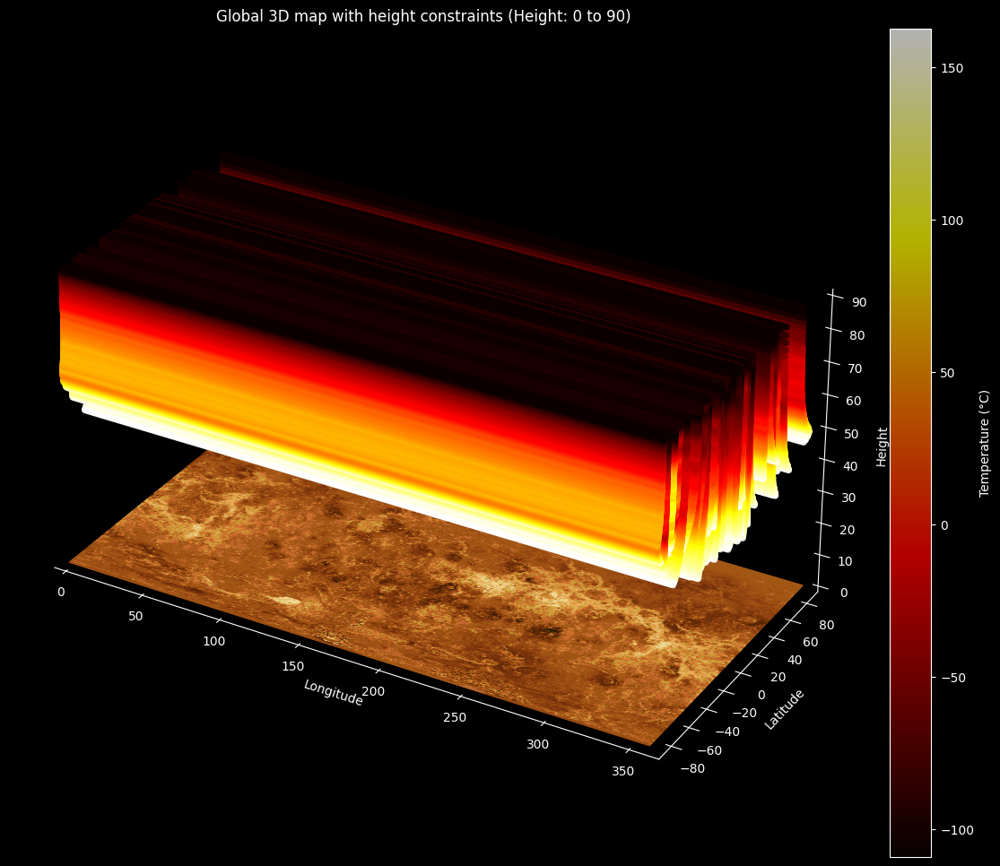

In [1]:
import os
import glob
import numpy as np
import pandas as pd
from matplotlib.image import imread
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# Height constraints
height_min = 0
height_max =90
venus_radius = 6051.8

#Venus map as floor for the plot
image = imread('/home/dev/Desktop/Venus/Images/venmap.gif')
img = image.astype("float32")/255
image_aspect_ratio = image.shape[1] / image.shape[0]
##Create a figure with dimensions based on the image aspect ratio
width = 30
height = width / image_aspect_ratio

# Create a figure and a 3D axis
plt.style.use('dark_background') # Dark theme
fig = plt.figure(figsize=(15, 12))
ax = fig.add_subplot(111, projection='3d')
ax.set_box_aspect((width, height, height))

x = np.linspace(0, 360, img.shape[1])
y = np.linspace(-90, 90, img.shape[0])

X, Y = np.meshgrid(x, y)
ax.plot_surface(X, Y, np.atleast_2d(0.), rstride=10,cstride=10, facecolors=img, shade=False)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)
    
    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    temperature = df.iloc[:,18]
    height = df.iloc[:,3] - venus_radius
    
    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    temperature = temperature[mask]
    height = height[mask]
    
    # Repeat temperature value for all longitudes
    repeated_temp = np.repeat(temperature, 361)

    # Create latitude and height grids for plotting
    lon, lat = np.meshgrid(np.arange(0, 361), latitude)
    h = np.ones_like(lon) * height.values[:, np.newaxis]

    # Plot latitude, longitude, and temperature in 3D
    scatter = ax.scatter(lon, lat, h, c=repeated_temp-273, cmap='hot', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Height')
    ax.set_title('Global 3D map with height constraints (Height: {} to {})'.format(height_min, height_max))
    
# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Temperature (°C)')

# Make planes transparent
ax.xaxis.pane.fill = False # Left plane
ax.yaxis.pane.fill = False # Right plane
# ax.zaxis.pane.fill = False # Horizontal plane

# Remove grid lines
ax.grid(False)

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_zlim(0, 90)
# ax.set_clim(-5,150)
# Remove tick labels
# ax.set_xticklabels([])
# ax.set_yticklabels([])
# ax.set_zticklabels([])

# Transparent spines
# ax.xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
# ax.yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
# ax.zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))

# Transparent panes
ax.xaxis.set_pane_color((0.0, 0.0, 1.0, 0.0))
ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))

# No ticks
# ax.set_xticks([]) 
# ax.set_yticks([]) 
# ax.set_zticks([])

# Show the plot
plt.show()

#### Plotting pressure

##### 2D plots with height constraints

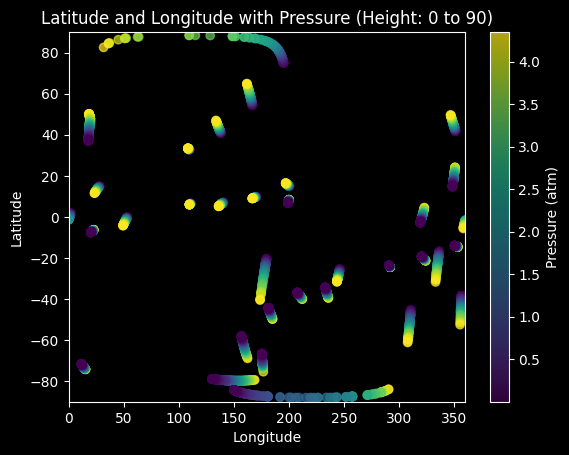

In [7]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# constraints
height_min = 0
height_max = 90
venus_radius = 6051.8

# Create a figure and axes
fig, ax = plt.subplots()

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            
# Iterate over the files in the combo folder
for csv_file in csv_files:
    file_path = os.path.basename(csv_file)
    # Load the combined dataset
    df = pd.read_csv(csv_file)

    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    pressure = df.iloc[:,12]
    height = df.iloc[:,3] - venus_radius

    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    pressure = pressure[mask]

    # Plot latitude, longitude, and pressure
    scatter = ax.scatter(longitude, latitude, c=pressure/101300, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Latitude and Longitude with Pressure (Height: {} to {})'.format(height_min, height_max))

# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Pressure (atm)')

# Show the plot
plt.show()


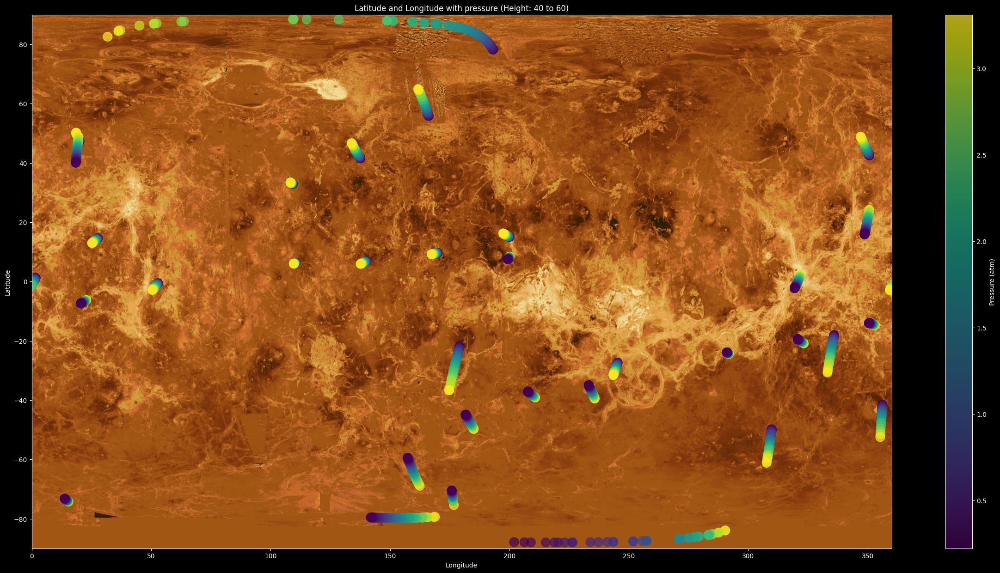

In [8]:
import os
import pandas as pd
import matplotlib.pyplot as plt


# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# constraints
height_min = 40
height_max = 60
venus_radius = 6051.8

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            
# Calculate the aspect ratio of the image
# image = plt.imread('/home/dev/Desktop/Venus/Images/venmap2.tif')
image = plt.imread('/home/dev/Desktop/Venus/Images/venmap.gif')
# image = plt.imread(image_path)
image_aspect_ratio = image.shape[1] / image.shape[0]

# Create a figure with dimensions based on the image aspect ratio
width = 30
height = width / image_aspect_ratio
fig, ax = plt.subplots(figsize=(width, height))

# Display the image as the background
ax.imshow(image, extent=[0, 360, -90, 90], aspect='auto')

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)

    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    pressure = df.iloc[:,12]
    height = df.iloc[:,3] - venus_radius

    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    pressure = pressure[mask]

    # Plot latitude, longitude, and pressure
    scatter = ax.scatter(longitude, latitude, c=pressure/101300,s=200, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Latitude and Longitude with pressure (Height: {} to {})'.format(height_min, height_max))

# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Pressure (atm)')

# Show the plot
plt.show()


##### 3D plots with height constraints

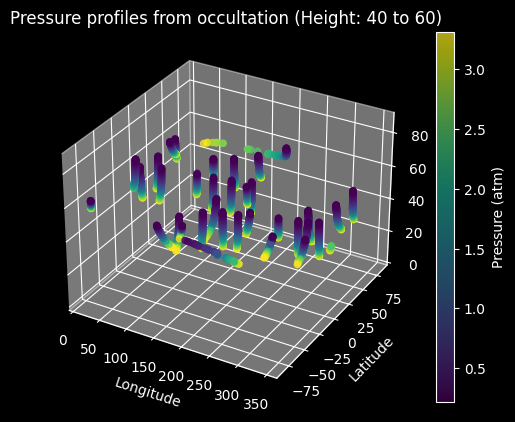

In [9]:
venus_radius = 6051.8

import os
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# Height constraints
height_min = 40
height_max = 60

# Create a figure and a 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_zlim(0, 90)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)
    
    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    pressure = df.iloc[:,12]
    height = df.iloc[:,3] - venus_radius
    
    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    pressure = pressure[mask]
    height = height[mask]
    
    # Plot latitude, longitude, and pressure within the height range
    scatter = ax.scatter(longitude, latitude, height, c=pressure/101300, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Height')
    ax.set_title('Pressure profiles from occultation (Height: {} to {})'.format(height_min, height_max))
        
# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Pressure (atm)')

# Show the plot
plt.show()

##### Global 3D map with height constraints

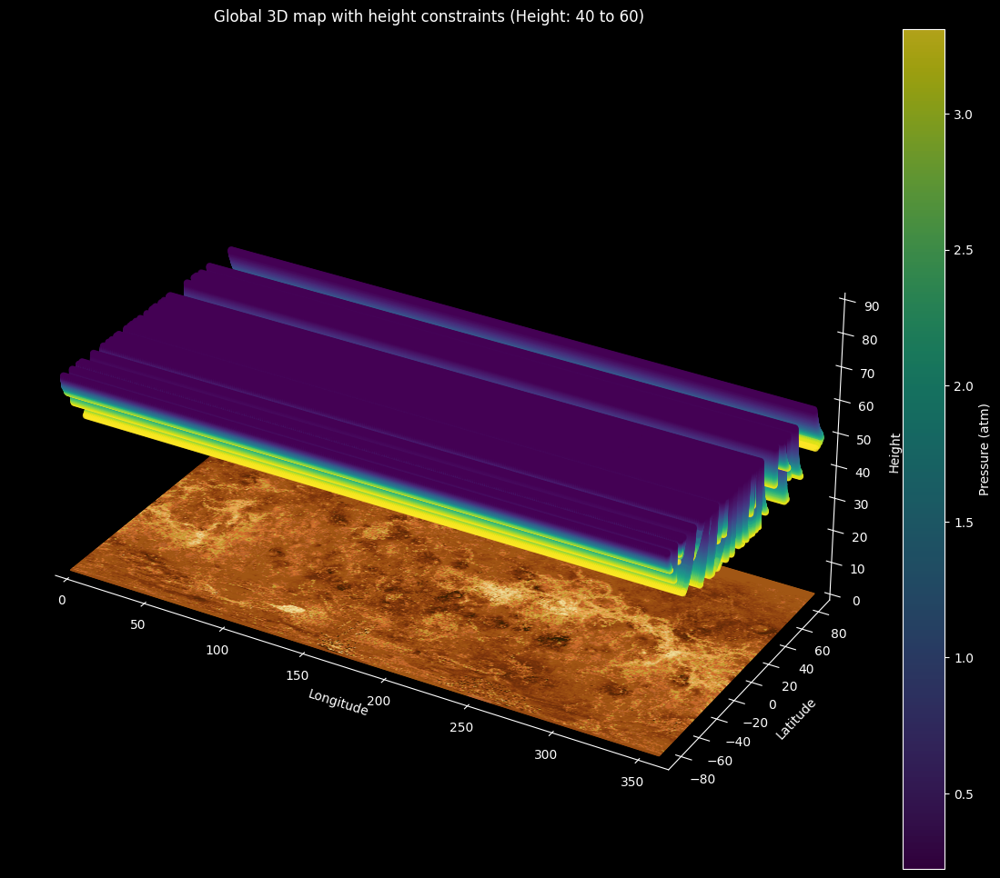

In [10]:
import os
import glob
import numpy as np
import pandas as pd
from matplotlib.image import imread
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# Height constraints
height_min = 40
height_max = 60
venus_radius = 6051.8

#Venus map as floor for the plot
image = imread('/home/dev/Desktop/Venus/Images/venmap.gif')
img = image.astype("float32")/255
image_aspect_ratio = image.shape[1] / image.shape[0]
##Create a figure with dimensions based on the image aspect ratio
width = 30
height = width / image_aspect_ratio

# Create a figure and a 3D axis
plt.style.use('dark_background') # Dark theme
fig = plt.figure(figsize=(15, 12))
ax = fig.add_subplot(111, projection='3d')
ax.set_box_aspect((width, height, height))

x = np.linspace(0, 360, img.shape[1])
y = np.linspace(-90, 90, img.shape[0])

X, Y = np.meshgrid(x, y)
ax.plot_surface(X, Y, np.atleast_2d(0.), rstride=10,cstride=10, facecolors=img, shade=False)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)
    
    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    pressure = df.iloc[:,12]
    height = df.iloc[:,3] - venus_radius
    
    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    pressure = pressure[mask]
    height = height[mask]
    
    # Repeat pressure value for all longitudes
    repeated_pressure = np.repeat(pressure, 361)

    # Create latitude and height grids for plotting
    lon, lat = np.meshgrid(np.arange(0, 361), latitude)
    h = np.ones_like(lon) * height.values[:, np.newaxis]

    # Plot latitude, longitude, and pressure in 3D
    scatter = ax.scatter(lon, lat, h, c=repeated_pressure/101300, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Height')
    ax.set_title('Global 3D map with height constraints (Height: {} to {})'.format(height_min, height_max))
    
# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Pressure (atm)')

# Make planes transparent
ax.xaxis.pane.fill = False # Left plane
ax.yaxis.pane.fill = False # Right plane
# ax.zaxis.pane.fill = False # Horizontal plane

# Remove grid lines
ax.grid(False)

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_zlim(0, 90)
# ax.set_clim(-5,150)
# Remove tick labels
# ax.set_xticklabels([])
# ax.set_yticklabels([])
# ax.set_zticklabels([])

# Transparent spines
# ax.xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
# ax.yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
# ax.zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))

# Transparent panes
ax.xaxis.set_pane_color((0.0, 0.0, 1.0, 0.0))
ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))

# No ticks
# ax.set_xticks([]) 
# ax.set_yticks([]) 
# ax.set_zticks([])

# Show the plot
plt.show()

#### Plotting Number Density

##### 2D plots with height constraints

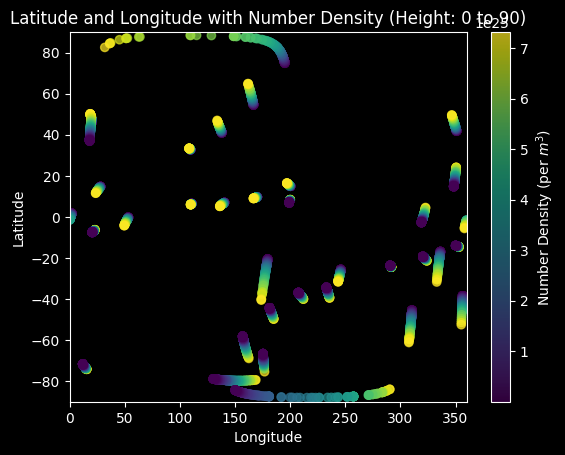

In [11]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# constraints
height_min = 0
height_max = 90
venus_radius = 6051.8

# Create a figure and axes
fig, ax = plt.subplots()

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            
# Iterate over the files in the combo folder
for csv_file in csv_files:
    file_path = os.path.basename(csv_file)
    # Load the combined dataset
    df = pd.read_csv(csv_file)

    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    density = df.iloc[:,20]
    height = df.iloc[:,3] - venus_radius

    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    density = density[mask]

    # Plot latitude, longitude, and density
    scatter = ax.scatter(longitude, latitude, c=density, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Latitude and Longitude with Number Density (Height: {} to {})'.format(height_min, height_max))

# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Number Density (per $m^{3}$)')

# Show the plot
plt.show()


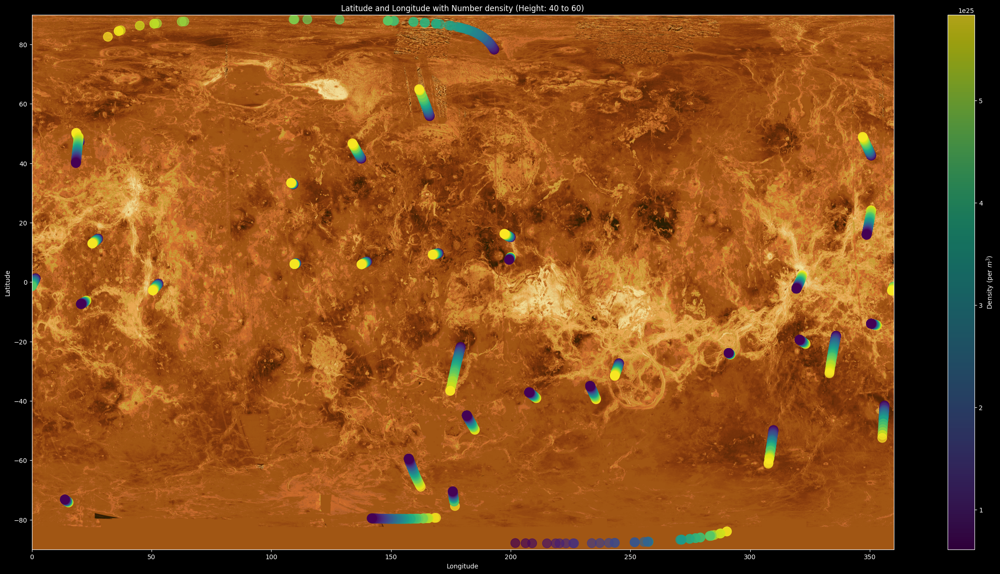

In [12]:
import os
import pandas as pd
import matplotlib.pyplot as plt


# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# constraints
height_min = 40
height_max = 60
venus_radius = 6051.8

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            
# Calculate the aspect ratio of the image
# image = plt.imread('/home/dev/Desktop/Venus/Images/venmap2.tif')
image = plt.imread('/home/dev/Desktop/Venus/Images/venmap.gif')
# image = plt.imread(image_path)
image_aspect_ratio = image.shape[1] / image.shape[0]

# Create a figure with dimensions based on the image aspect ratio
width = 30
height = width / image_aspect_ratio
fig, ax = plt.subplots(figsize=(width, height))

# Display the image as the background
ax.imshow(image, extent=[0, 360, -90, 90], aspect='auto')

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)

    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    density = df.iloc[:,20]
    height = df.iloc[:,3] - venus_radius

    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    density = density[mask]

    # Plot latitude, longitude, and density
    scatter = ax.scatter(longitude, latitude, c=density,s=200, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Latitude and Longitude with Number density (Height: {} to {})'.format(height_min, height_max))

# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Density (per $m^{3}$)')

# Show the plot
plt.show()


##### 3D plots with height constraints

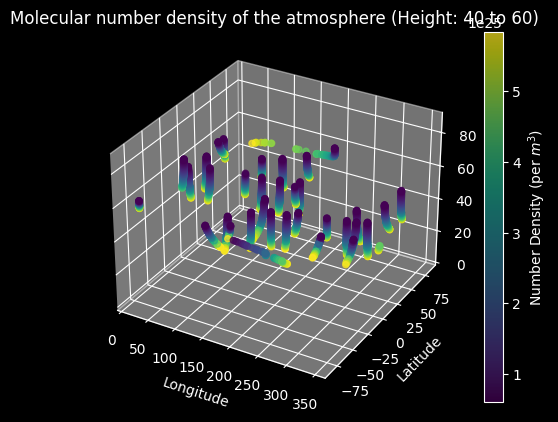

In [13]:
venus_radius = 6051.8

import os
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# Height constraints
height_min = 40
height_max = 60

# Create a figure and a 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_zlim(0, 90)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)
    
    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    density = df.iloc[:,20]
    height = df.iloc[:,3] - venus_radius
    
    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    density = density[mask]
    height = height[mask]
    
    # Plot latitude, longitude, and density within the height range
    scatter = ax.scatter(longitude, latitude, height, c=density-273, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Height')
    ax.set_title('Molecular number density of the atmosphere (Height: {} to {})'.format(height_min, height_max))
        
# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Number Density (per $m^{3}$)')

# Show the plot
plt.show()

##### Global 3D map with height constraints

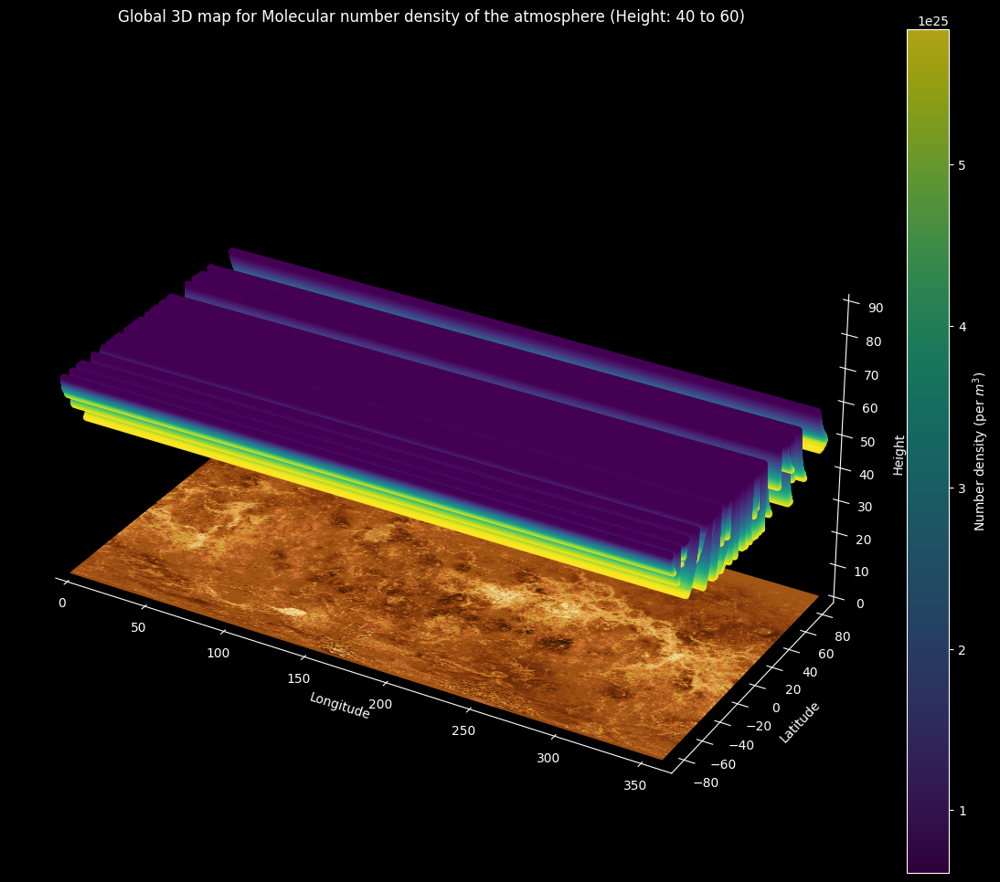

In [14]:
import os
import glob
import numpy as np
import pandas as pd
from matplotlib.image import imread
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l4']
subsubdirectories=['ingress','egress']

# Height constraints
height_min = 40
height_max = 60
venus_radius = 6051.8

#Venus map as floor for the plot
image = imread('/home/dev/Desktop/Venus/Images/venmap.gif')
img = image.astype("float32")/255
image_aspect_ratio = image.shape[1] / image.shape[0]
##Create a figure with dimensions based on the image aspect ratio
width = 30
height = width / image_aspect_ratio

# Create a figure and a 3D axis
plt.style.use('dark_background') # Dark theme
fig = plt.figure(figsize=(15, 12))
ax = fig.add_subplot(111, projection='3d')
ax.set_box_aspect((width, height, height))

x = np.linspace(0, 360, img.shape[1])
y = np.linspace(-90, 90, img.shape[0])

X, Y = np.meshgrid(x, y)
ax.plot_surface(X, Y, np.atleast_2d(0.), rstride=10,cstride=10, facecolors=img, shade=False)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)
    
    # Extract the required columns
    latitude = df.iloc[:,4]
    longitude = df.iloc[:,5]
    density = df.iloc[:,20]
    height = df.iloc[:,3] - venus_radius
    
    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    density = density[mask]
    height = height[mask]
    
    # Repeat density value for all longitudes
    repeated_density = np.repeat(density, 361)

    # Create latitude and height grids for plotting
    lon, lat = np.meshgrid(np.arange(0, 361), latitude)
    h = np.ones_like(lon) * height.values[:, np.newaxis]

    # Plot latitude, longitude, and density in 3D
    scatter = ax.scatter(lon, lat, h, c=repeated_density, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Height')
    ax.set_title('Global 3D map for Molecular number density of the atmosphere (Height: {} to {})'.format(height_min, height_max))
    
# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='Number density (per $m^{3}$)')

# Make planes transparent
ax.xaxis.pane.fill = False # Left plane
ax.yaxis.pane.fill = False # Right plane
# ax.zaxis.pane.fill = False # Horizontal plane

# Remove grid lines
ax.grid(False)

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_zlim(0, 90)
# ax.set_clim(-5,150)
# Remove tick labels
# ax.set_xticklabels([])
# ax.set_yticklabels([])
# ax.set_zticklabels([])

# Transparent spines
# ax.xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
# ax.yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
# ax.zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))

# Transparent panes
ax.xaxis.set_pane_color((0.0, 0.0, 1.0, 0.0))
ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))

# No ticks
# ax.set_xticks([]) 
# ax.set_yticks([]) 
# ax.set_zticks([])

# Show the plot
plt.show()

#### Plotting refractive index

##### 2D plots with height constraints

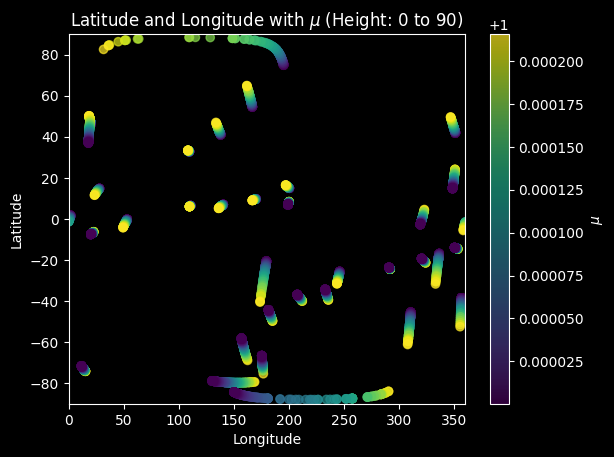

In [15]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l3']
subsubdirectories=['ingress','egress']

# constraints
height_min = 0
height_max = 90
venus_radius = 6051.8

# Create a figure and axes
fig, ax = plt.subplots()

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            
# Iterate over the files in the combo folder
for csv_file in csv_files:
    file_path = os.path.basename(csv_file)
    # Load the combined dataset
    df = pd.read_csv(csv_file)

    # Extract the required columns
    latitude = df.iloc[:,18]
    longitude = df.iloc[:,17]
    mu = df.iloc[:,10]
    height = df.iloc[:,6] - venus_radius

    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    mu = mu[mask]

    # Plot latitude, longitude, and mu
    scatter = ax.scatter(longitude, latitude, c=mu, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Latitude and Longitude with $\mu$ (Height: {} to {})'.format(height_min, height_max))

# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='$\mu$ ')

# Show the plot
plt.show()


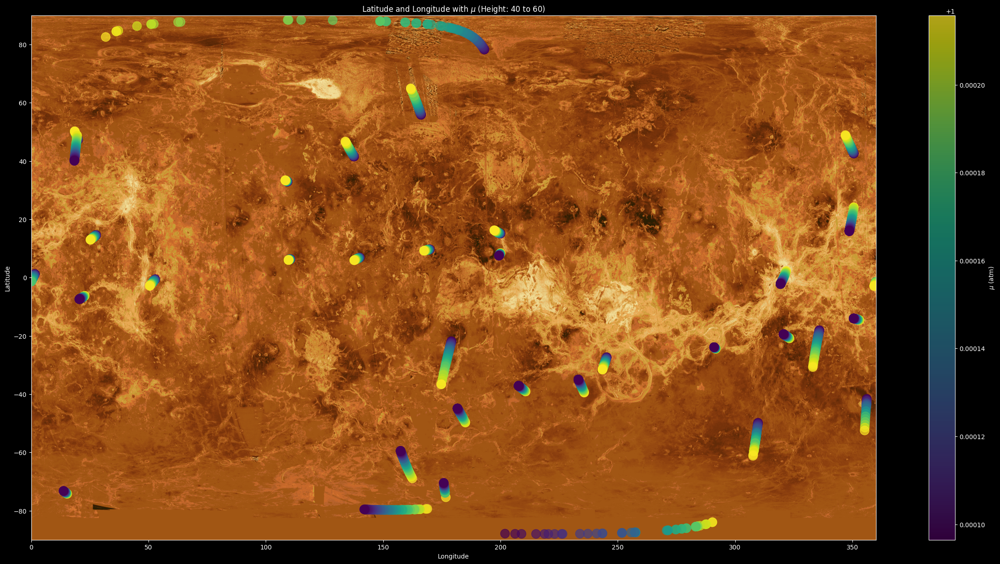

In [16]:
import os
import pandas as pd
import matplotlib.pyplot as plt


# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l3']
subsubdirectories=['ingress','egress']

# constraints
height_min = 40
height_max = 60
venus_radius = 6051.8

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            
# Calculate the aspect ratio of the image
# image = plt.imread('/home/dev/Desktop/Venus/Images/venmap2.tif')
image = plt.imread('/home/dev/Desktop/Venus/Images/venmap.gif')
# image = plt.imread(image_path)
image_aspect_ratio = image.shape[1] / image.shape[0]

# Create a figure with dimensions based on the image aspect ratio
width = 30
height = width / image_aspect_ratio
fig, ax = plt.subplots(figsize=(width, height))

# Display the image as the background
ax.imshow(image, extent=[0, 360, -90, 90], aspect='auto')

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)

    # Extract the required columns
    latitude = df.iloc[:,18]
    longitude = df.iloc[:,17]
    mu = df.iloc[:,10]
    height = df.iloc[:,6] - venus_radius

    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    mu = mu[mask]

    # Plot latitude, longitude, and mu
    scatter = ax.scatter(longitude, latitude, c=mu,s=200, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title('Latitude and Longitude with $\mu$ (Height: {} to {})'.format(height_min, height_max))

# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='$\mu$ (atm)')

# Show the plot
plt.show()


##### 3D plots with height constraints

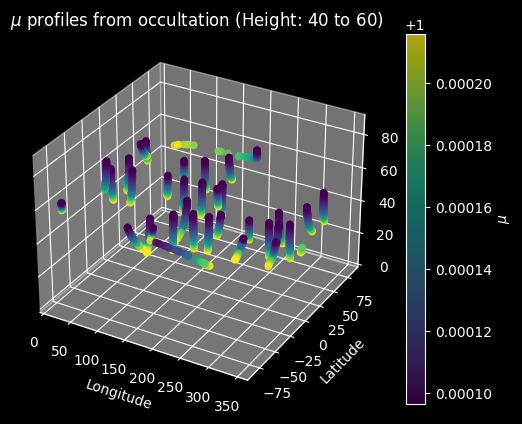

In [17]:
venus_radius = 6051.8

import os
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l3']
subsubdirectories=['ingress','egress']

# Height constraints
height_min = 40
height_max = 60

# Create a figure and a 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_zlim(0, 90)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)
    
    # Extract the required columns
    latitude = df.iloc[:,18]
    longitude = df.iloc[:,17]
    mu = df.iloc[:,10]
    height = df.iloc[:,6] - venus_radius
    
    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    mu = mu[mask]
    height = height[mask]
    
    # Plot latitude, longitude, and mu within the height range
    scatter = ax.scatter(longitude, latitude, height, c=mu, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Height')
    ax.set_title('$\mu$ profiles from occultation (Height: {} to {})'.format(height_min, height_max))
        
# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='$\mu$')

# Show the plot
plt.show()

##### Global 3D map with height constraints

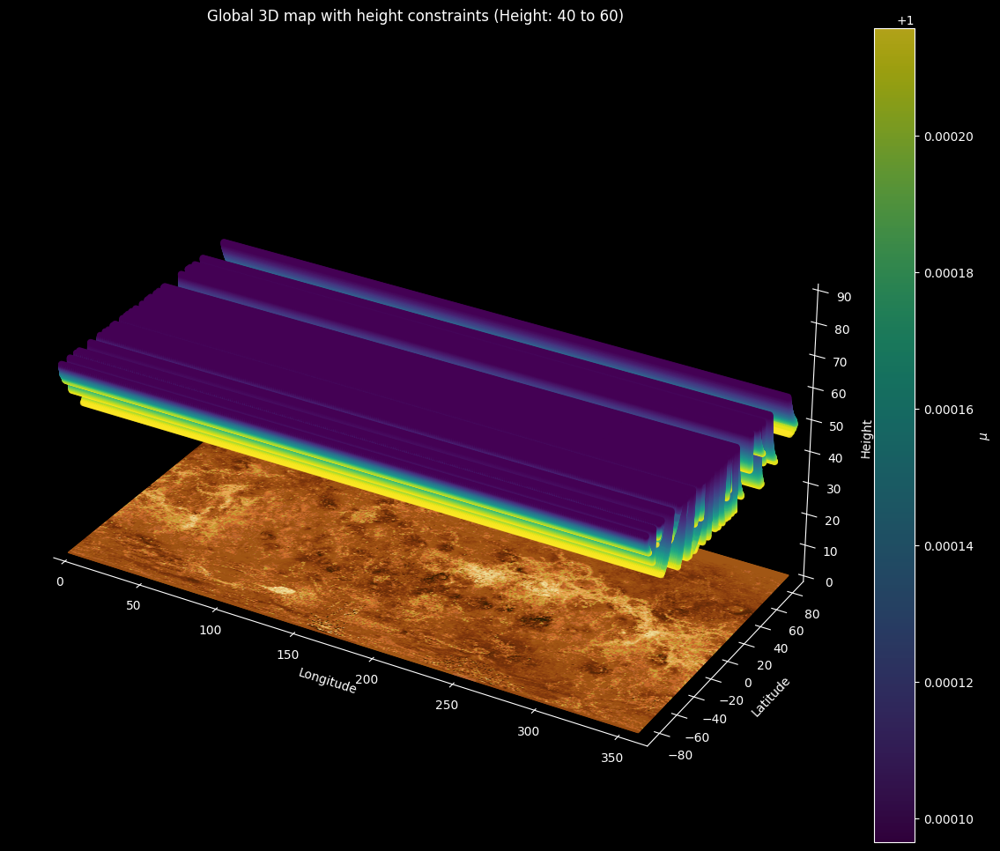

In [18]:
import os
import glob
import numpy as np
import pandas as pd
from matplotlib.image import imread
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Path to the l4 data
combo_folder = '/home/dev/Desktop/Venus/Data/'
directory = ['vcors_2001','vcors_2002','vcors_2003','vcors_2004']
subdirectory = ['l3']
subsubdirectories=['ingress','egress']

# Height constraints
height_min = 40
height_max = 60
venus_radius = 6051.8

#Venus map as floor for the plot
image = imread('/home/dev/Desktop/Venus/Images/venmap.gif')
img = image.astype("float32")/255
image_aspect_ratio = image.shape[1] / image.shape[0]
##Create a figure with dimensions based on the image aspect ratio
width = 30
height = width / image_aspect_ratio

# Create a figure and a 3D axis
plt.style.use('dark_background') # Dark theme
fig = plt.figure(figsize=(15, 12))
ax = fig.add_subplot(111, projection='3d')
ax.set_box_aspect((width, height, height))

x = np.linspace(0, 360, img.shape[1])
y = np.linspace(-90, 90, img.shape[0])

X, Y = np.meshgrid(x, y)
ax.plot_surface(X, Y, np.atleast_2d(0.), rstride=10,cstride=10, facecolors=img, shade=False)

csv_files = []

# Find all CSV files in the 'l4' folder and its subfolders
for directory in directory:
    for subdirectory in subdirectory:
        for subsubdirectory in subsubdirectories:
            folder_path = os.path.join(combo_folder, directory, subdirectory, subsubdirectory)
            files = glob.glob(os.path.join(folder_path, '*.csv'))
            csv_files.extend(files)
            

# Iterate over the files in the combo folder
for csv_file in csv_files:
    # Load the combined dataset
    df = pd.read_csv(csv_file)
    
    # Extract the required columns
    latitude = df.iloc[:,18]
    longitude = df.iloc[:,17]
    mu = df.iloc[:,10]
    height = df.iloc[:,6] - venus_radius
    
    # Filter data based on height constraints
    mask = (height >= height_min) & (height <= height_max)
    latitude = latitude[mask]
    longitude = longitude[mask]
    mu = mu[mask]
    height = height[mask]
    
    # Repeat mu value for all longitudes
    repeated_mu = np.repeat(mu, 361)

    # Create latitude and height grids for plotting
    lon, lat = np.meshgrid(np.arange(0, 361), latitude)
    h = np.ones_like(lon) * height.values[:, np.newaxis]

    # Plot latitude, longitude, and mu in 3D
    scatter = ax.scatter(lon, lat, h, c=repeated_mu, cmap='viridis', alpha=0.7)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Height')
    ax.set_title('Global 3D map with height constraints (Height: {} to {})'.format(height_min, height_max))
    
# Add a colorbar
cbar = fig.colorbar(scatter, ax=ax, label='$\mu$')

# Make planes transparent
ax.xaxis.pane.fill = False # Left plane
ax.yaxis.pane.fill = False # Right plane
# ax.zaxis.pane.fill = False # Horizontal plane

# Remove grid lines
ax.grid(False)

# Set axis limits
ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_zlim(0, 90)
# ax.set_clim(-5,150)
# Remove tick labels
# ax.set_xticklabels([])
# ax.set_yticklabels([])
# ax.set_zticklabels([])

# Transparent spines
# ax.xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
# ax.yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
# ax.zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))

# Transparent panes
ax.xaxis.set_pane_color((0.0, 0.0, 1.0, 0.0))
ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))

# No ticks
# ax.set_xticks([]) 
# ax.set_yticks([]) 
# ax.set_zticks([])

# Show the plot
plt.show()